# Project 1 - Network Centrality and Categorical Data
###### Stefano Biguzzi, Dennis Pong, Ian Costello

## Assignment Description

For your first project, you are asked to:

1. Identify and load a network dataset that has some categorical information available for each node.
2. For each of the nodes in the dataset, calculate degree centrality and eigenvector centrality.
3. Compare your centrality measures across your categorical groups.

For example, using the dataset from a study of romantic relationships among high school students in Columbus, Ohio [http://researchnews.osu.edu/archive/chains.htm], you might want to determine if there are any differences in your calculated centrality measures between the two sexes.  You might use a t-test or another statistical measure to support your findings.

You may work in a small group.  Your project should be delivered in an Jupyter Notebook, and posted in GitHub.  Your project is due end of day Sunday. You and your team should created a video presentation about your project. You should be ready to present your project in our Meet-up.

## Assignment Steps

### Loading Libraries and Data Wrangling
First import the libraries necessary for this assignment: `networkx` as "nx", ` as "net". We also import `pandas`.

In [1]:
import networkx as nx
import pandas as pd
from itertools import islice
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.pyplot import figure
from tabulate import tabulate
from collections import Counter
from operator import itemgetter

In [2]:
de_url = 'https://raw.githubusercontent.com/iscostello/data620/main/Assignments/Project1/musae_DE_edges.csv'
de_twitch_data = pd.read_csv(de_url,header=0)[:1500]
de_twitch_data['from_new'] = 'DE' + de_twitch_data['from'].astype(str)
de_twitch_data['language'] = 'German'
de_twitch_data = de_twitch_data[['from_new','to','language']]


de_twitch_data.head()

,from_new,to,language
0,DE0,9206,German
1,DE0,7787,German
2,DE0,2145,German
3,DE0,2684,German
4,DE0,7275,German


In [3]:
en_url = 'https://raw.githubusercontent.com/iscostello/data620/main/Assignments/Project1/musae_ENGB_edges.csv'
en_twitch_data = pd.read_csv(en_url,header=0)[:1500]
en_twitch_data['from_new'] = 'EN' + en_twitch_data['from'].astype(str)
en_twitch_data['language'] = 'English'
en_twitch_data = en_twitch_data[['from_new','to','language']]


en_twitch_data.head()

,from_new,to,language
0,EN6194,255,English
1,EN6194,980,English
2,EN6194,2992,English
3,EN6194,2507,English
4,EN6194,986,English


In [4]:
ru_url = 'https://raw.githubusercontent.com/iscostello/data620/main/Assignments/Project1/musae_RU_edges.csv'
ru_twitch_data = pd.read_csv(ru_url,header=0)[:1500]
ru_twitch_data['from_new'] = 'RU' + ru_twitch_data['from'].astype(str)
ru_twitch_data['language'] = 'Russian'
ru_twitch_data = ru_twitch_data[['from_new', 'to', 'language']]


ru_twitch_data.head()

,from_new,to,language
0,RU0,646,Russian
1,RU0,2510,Russian
2,RU0,2425,Russian
3,RU0,2596,Russian
4,RU0,85,Russian


In [5]:
all_lang = pd.concat([de_twitch_data, en_twitch_data, ru_twitch_data])

## Setting Network Graphs

In [6]:
de_g = nx.Graph()
en_g = nx.Graph()
ru_g = nx.Graph()
lang_g = nx.Graph()

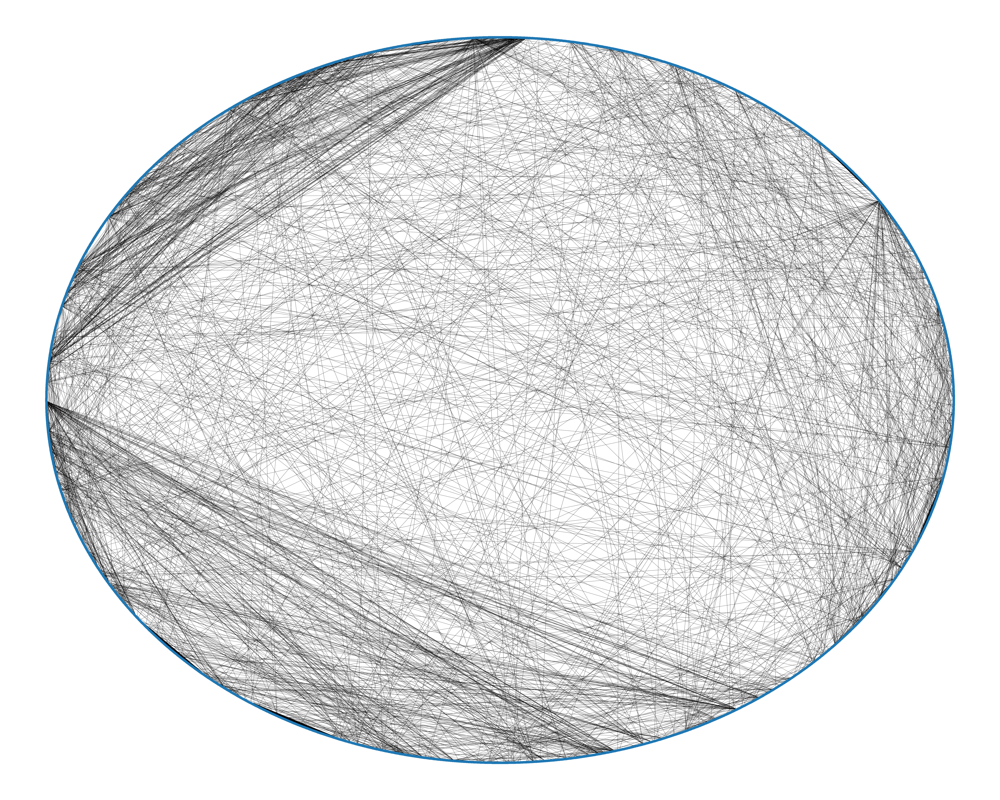

In [7]:
lang_g = nx.from_pandas_edgelist(all_lang, 'from_new', 'to', edge_attr = 'language')
de_g = nx.from_pandas_edgelist(de_twitch_data, 'from_new', 'to', edge_attr = 'language')
en_g = nx.from_pandas_edgelist(en_twitch_data, 'from_new', 'to', edge_attr = 'language')
ru_g = nx.from_pandas_edgelist(ru_twitch_data, 'from_new', 'to', edge_attr = 'language')

figure(figsize=(100, 80))
nx.draw_shell(lang_g, with_labels=False)

## Degree Centrality Analysis

In [8]:
degrees = nx.degree(lang_g)
degree_list = list(degrees)

In [9]:
sorted_degree_list = sorted(degree_list, key=lambda tup: tup[1], reverse=True)
print(tabulate(sorted_degree_list[0:10], headers = ['UserID', 'Degree'],tablefmt='fancy_grid'))

╒══════════╤══════════╕
│ UserID   │   Degree │
╞══════════╪══════════╡
│ EN93     │      154 │
├──────────┼──────────┤
│ RU6      │      137 │
├──────────┼──────────┤
│ DE21     │      136 │
├──────────┼──────────┤
│ DE27     │      136 │
├──────────┼──────────┤
│ EN24     │      122 │
├──────────┼──────────┤
│ RU57     │      118 │
├──────────┼──────────┤
│ EN26     │       90 │
├──────────┼──────────┤
│ DE11     │       80 │
├──────────┼──────────┤
│ RU74     │       71 │
├──────────┼──────────┤
│ DE72     │       65 │
╘══════════╧══════════╛


### Log-Log Plot

Text(0, 0.5, 'Frequency')

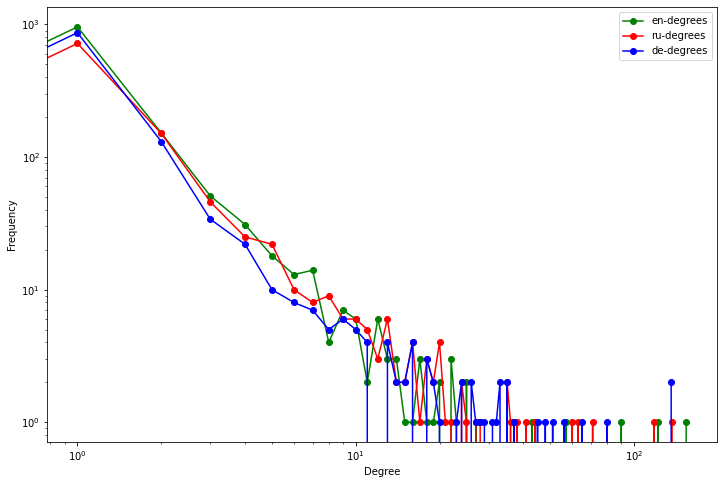

In [10]:
en_degree_freq = nx.degree_histogram(en_g)
ru_degree_freq = nx.degree_histogram(ru_g)
de_degree_freq = nx.degree_histogram(de_g)
degrees = range(len(en_degree_freq))
plt.figure(figsize=(12, 8)) 
plt.loglog(range(len(en_degree_freq)), en_degree_freq, 'go-', label='en-degrees') 
plt.loglog(range(len(ru_degree_freq)), ru_degree_freq, 'ro-', label='ru-degrees')
plt.loglog(range(len(de_degree_freq)), de_degree_freq, 'bo-', label='de-degrees')
plt.legend()
plt.xlabel('Degree')
plt.ylabel('Frequency')

### Visualizing Degree Centrality

In [11]:
def draw(G, pos, measures, measure_name):
    
    nodes = nx.draw_networkx_nodes(G, pos, node_size=400, cmap=plt.cm.plasma, 
                                   node_color=list(measures.values()),
                                   alpha = 0.25,
                                   nodelist=measures.keys())
    nodes.set_norm(mcolors.SymLogNorm(linthresh=0.01, linscale=1, base=10))
    # labels = nx.draw_networkx_labels(G, pos)
    edges = nx.draw_networkx_edges(G, pos)

    plt.title(measure_name)
    plt.colorbar(nodes)
    plt.axis('off')
    plt.show()
   



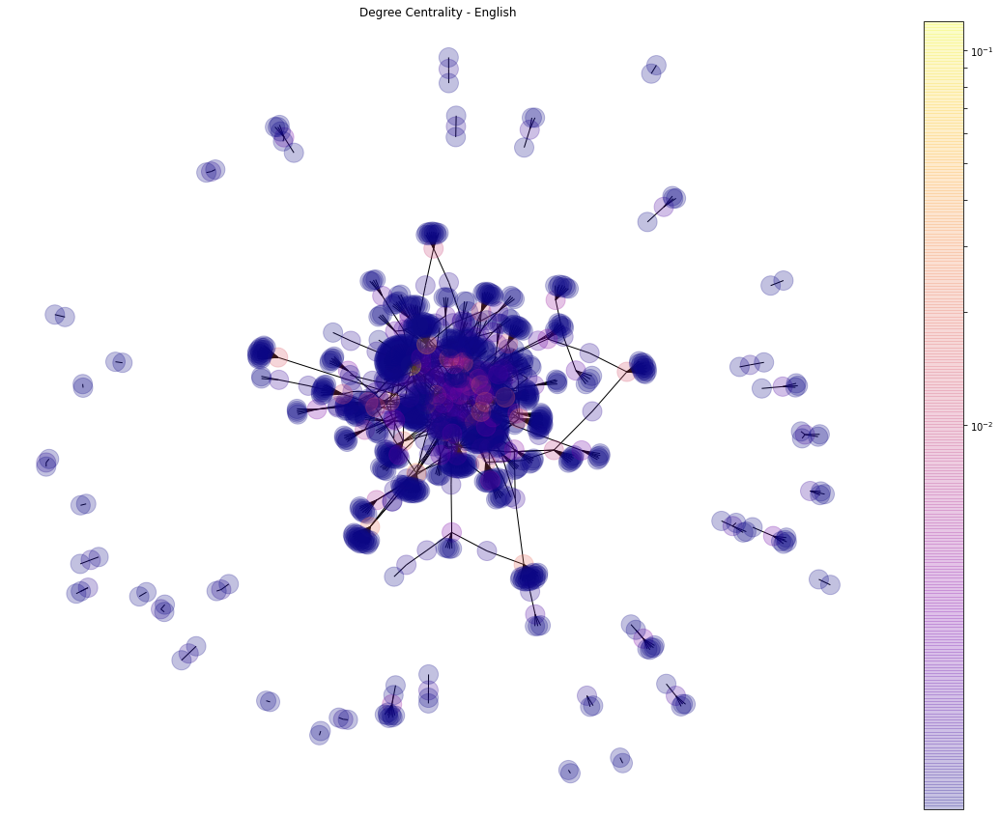

In [12]:
pos = nx.spring_layout(en_g, seed=675)
plt.figure(figsize=(20,15))
draw(en_g, pos, nx.degree_centrality(en_g), 'Degree Centrality - English')

In [1]:
pos = nx.spring_layout(ru_g, seed=675)
plt.figure(figsize=(20,15))
draw(ru_g, pos, nx.degree_centrality(ru_g), 'Degree Centrality - Russian')

NameError: name 'nx' is not defined

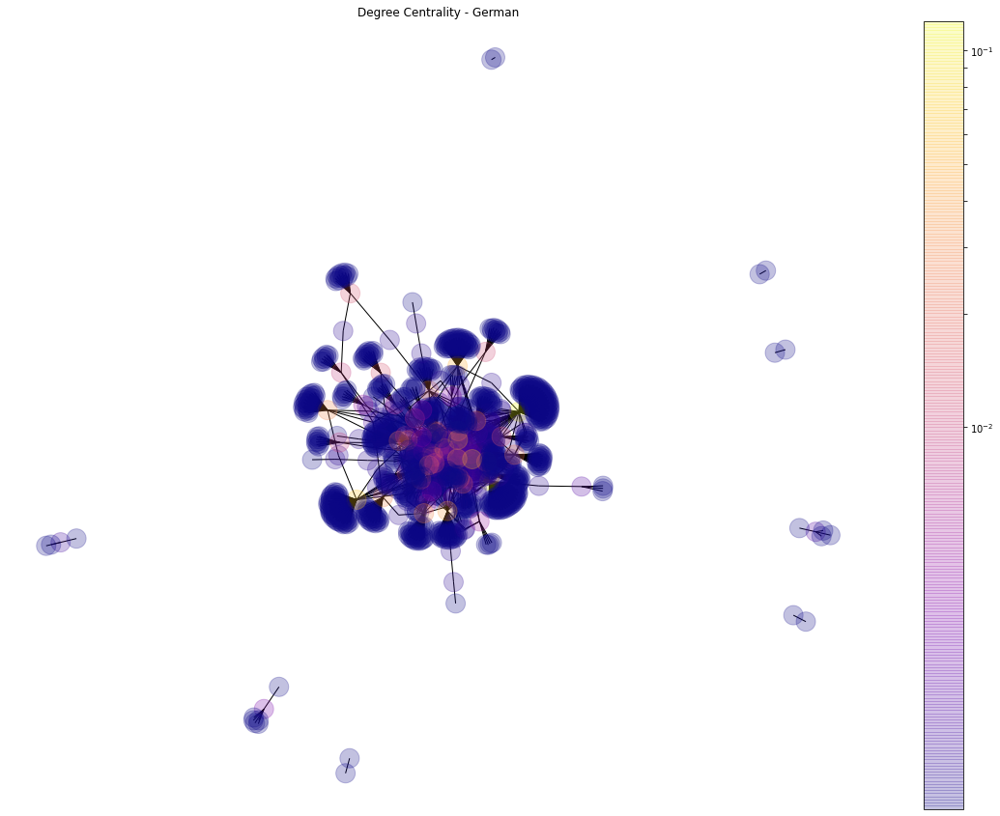

In [14]:
pos = nx.spring_layout(de_g, seed=675)
plt.figure(figsize=(20,15))
draw(de_g, pos, nx.degree_centrality(de_g), 'Degree Centrality - German')

## Eigenvector Centrality

### Visualizing Eigenvector Centrality

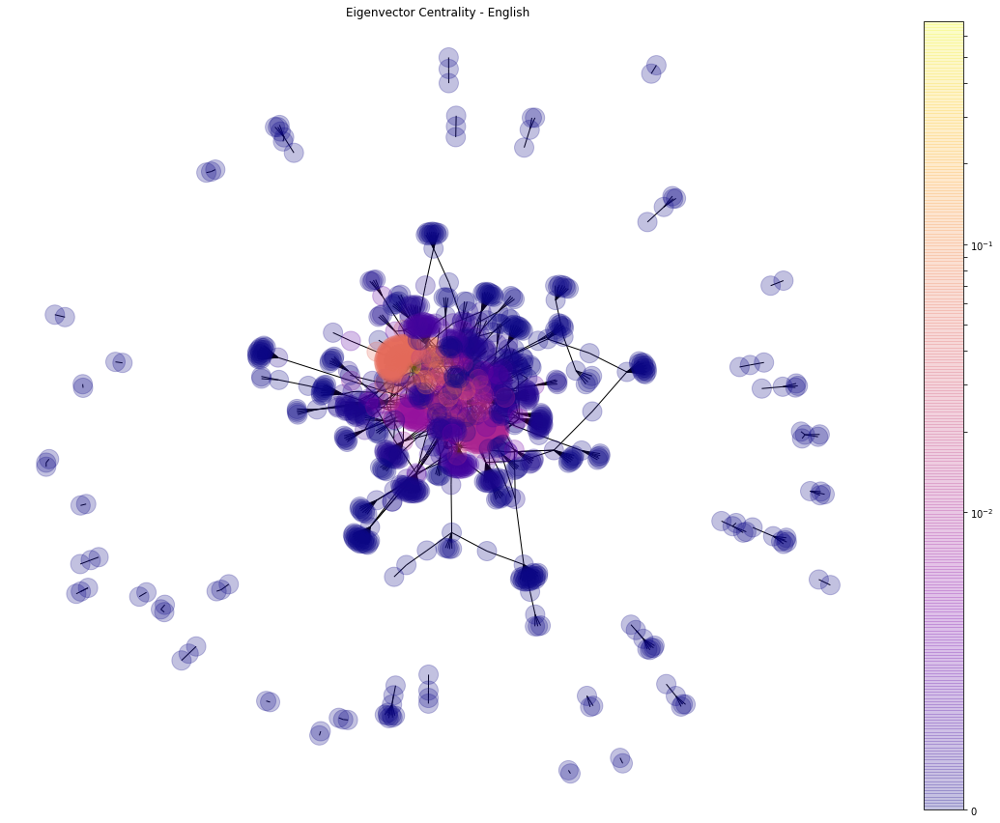

In [15]:
pos = nx.spring_layout(en_g, seed=675)
plt.figure(figsize=(20,15))
draw(en_g, pos, nx.eigenvector_centrality(en_g), 'Eigenvector Centrality - English')

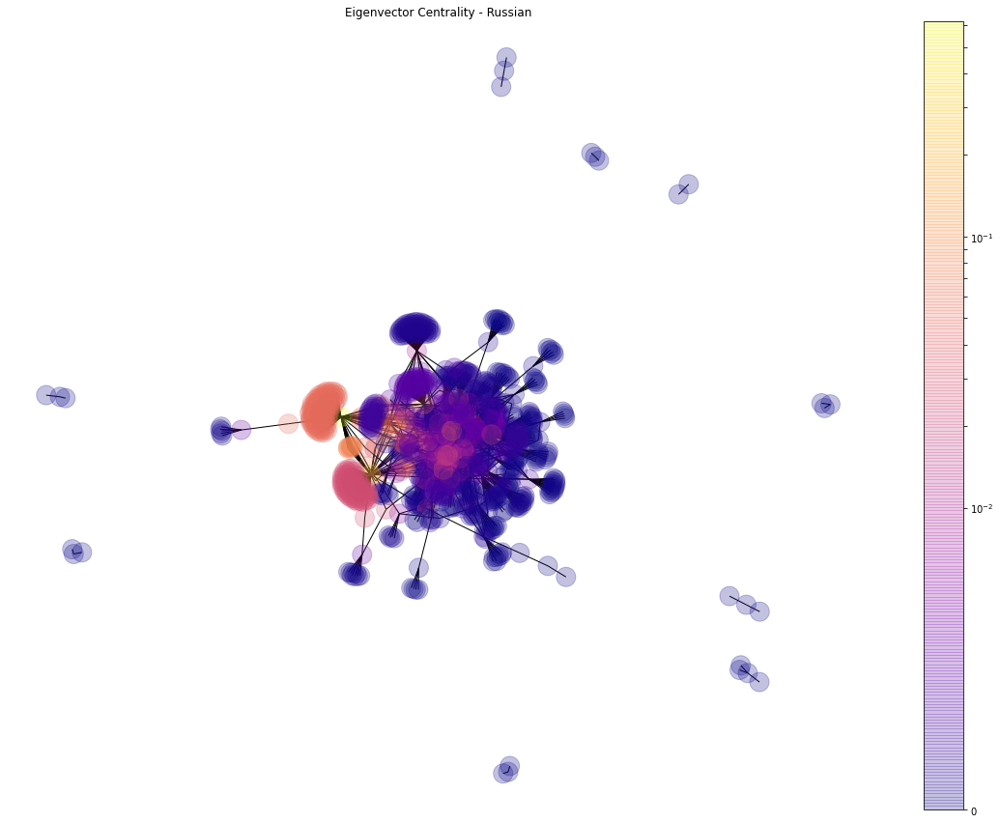

In [16]:
pos = nx.spring_layout(ru_g, seed=675)
plt.figure(figsize=(20,15))
draw(ru_g, pos, nx.eigenvector_centrality(ru_g), 'Eigenvector Centrality - Russian')

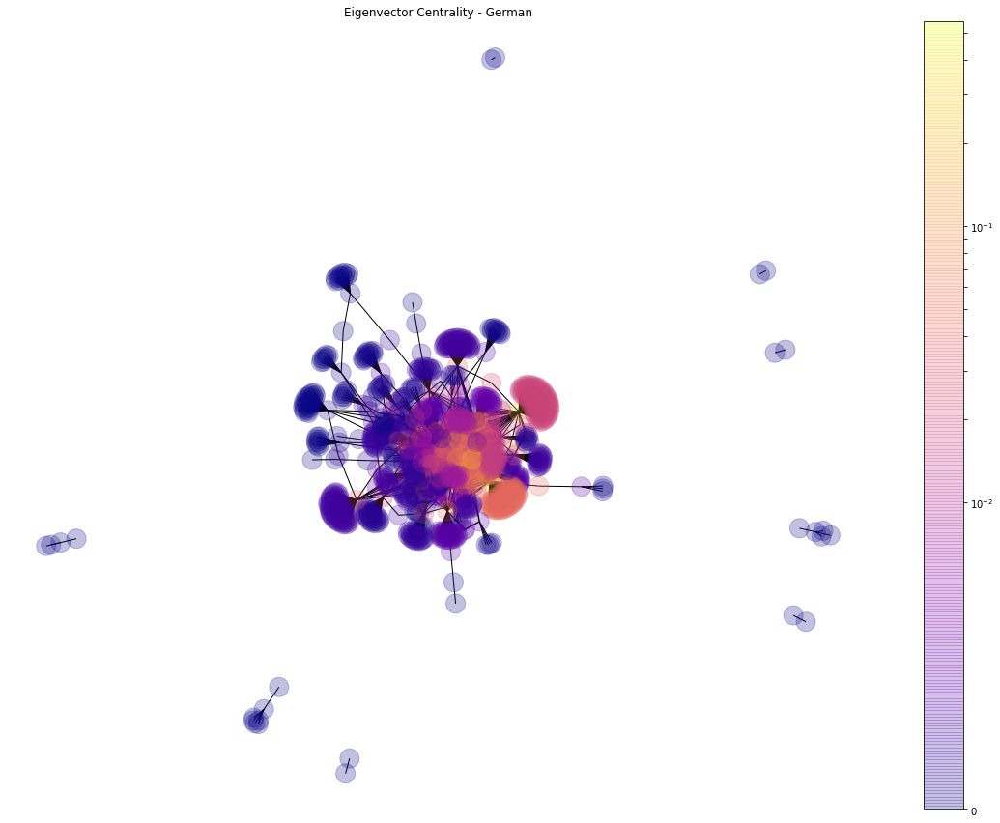

In [17]:
pos = nx.spring_layout(de_g, seed=675)
plt.figure(figsize=(20,15))
draw(de_g, pos, nx.eigenvector_centrality(de_g), 'Eigenvector Centrality - German')

## Statistical Observations

## Conclusions